ASSIGNMENT 1 - And The Earth Goes Round Again...

In [71]:
%matplotlib inline
import matplotlib.pyplot as plt
from matplotlib import animation
import numpy as np

Q1

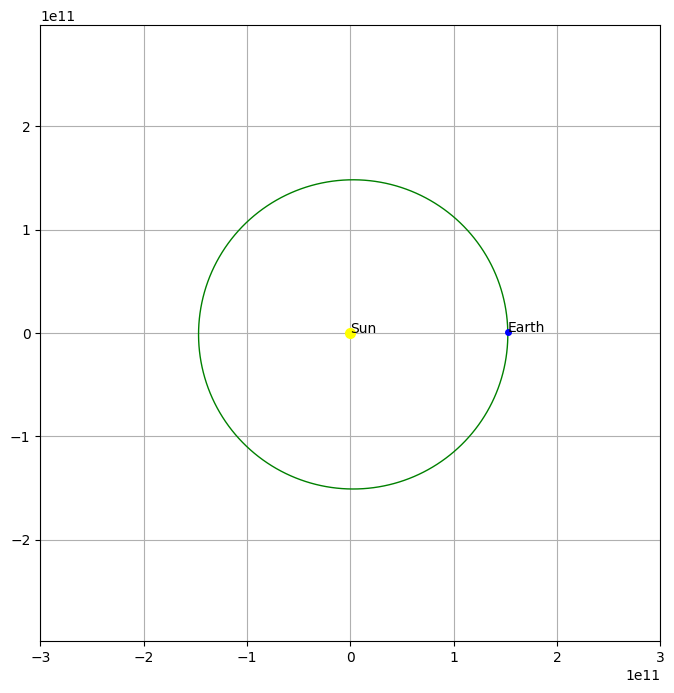

In [72]:
# Code for simulating an orbit of Earth and Sun

# Constants
G = 6.67e-11          # Gravitational constant
Ms = 2.0e30            # Mass of the Sun
Me = 5.972e24          # Mass of the Earth
AU = 1.5e11            # Astronomical Unit (average distance between the Earth and the Sun)
daysec = 24.0 * 60 * 60  # Number of seconds in a day
e_av = 29290           # Earth's aphelion velocity
gravconst = G * Me * Ms  # Gravitational constant multiplied by the masses

# Initial conditions
x, y, z = 1.0167 * AU, 0, 0   # Initial position of Earth
vx, vy, vz = 0, e_av, 0       # Initial velocity of Earth
xs, ys, zs = 0, 0, 0           # Initial position of the Sun
vxs, vys, vzs = 0, 0, 0        # Initial velocity of the Sun
t, dt = 0.0, 1 * daysec        # Initial time and time step

# Lists to store the positions of Earth and the Sun over time
xlist, ylist, zlist = [], [], []
xslist, yslist, zslist = [], [], []

# Start simulation
while t < 1 * 365 * daysec:
    # Calculate the gravitational force on Earth
    rx, ry, rz = x - xs, y - ys, z - zs
    modr3 = (rx**2 + ry**2 + rz**2)**1.5
    fx, fy, fz = -gravconst * rx / modr3, -gravconst * ry / modr3, -gravconst * rz / modr3

    # Update Earth's velocity and position
    vx += fx * dt / Me
    vy += fy * dt / Me
    vz += fz * dt / Me

    x += vx * dt
    y += vy * dt
    z += vz * dt

    # Save Earth's position
    xlist.append(x)
    ylist.append(y)
    zlist.append(z)

    # Update Sun's velocity and position
    vxs += -fx * dt / Ms
    vys += -fy * dt / Ms
    vzs += -fz * dt / Ms

    xs += vxs * dt
    ys += vys * dt
    zs += vzs * dt
    xslist.append(xs)
    yslist.append(ys)
    zslist.append(zs)

    # Update time
    t += dt

# Animation
plt.rcParams["animation.html"] = "jshtml"
fig, ax = plt.subplots(figsize=(8, 8))
ax.set_aspect('equal')
ax.grid()

# Plot for Earth's orbit
line, = ax.plot([], [], '-g', lw=1)
point, = ax.plot([AU], [0], marker="o", markersize=4, markeredgecolor="blue", markerfacecolor="blue")
text = ax.text(AU, 0, 'Earth')

# Plot for the Sun
point_s, = ax.plot([0], [0], marker="o", markersize=7, markeredgecolor="yellow", markerfacecolor="yellow")
text_s = ax.text(0, 0, 'Sun')

# Lists to store data for the animation
data_x, data_y = [], []

def update(i):
    data_x.append(xlist[i])
    data_y.append(ylist[i])
    
    # Update Earth's orbit plot
    line.set_data(data_x, data_y)
    point.set_data(xlist[i], ylist[i])
    text.set_position((xlist[i], ylist[i]))

    # Update Sun's position plot
    point_s.set_data(xslist[i], yslist[i])
    text_s.set_position((xslist[i], yslist[i]))
    
    # Set plot limits
    ax.axis('equal')
    ax.set_xlim(-2 * AU, 2 * AU)
    ax.set_ylim(-2 * AU, 2 * AU)
    
    return line, point_s, point, text, text_s

# Create animation
animation_obj = animation.FuncAnimation(fig, func=update, frames=len(xlist), interval=1, blit=True)
animation_obj


Q2

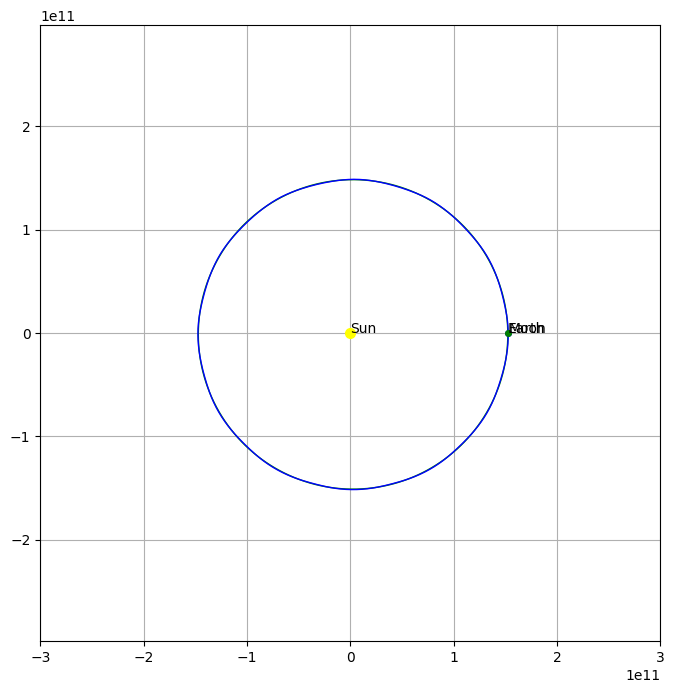

In [73]:
# Code for Earth - Moon - Sun System

# Constants
Mm = 7.34767e22                # Mass of the moon
em = 4.055e8                   # Earth-Moon distance
m_ap_v = 970                   # Moon velocity at aphelion

gravconst_e = G * Me * Ms
gravconst_m = G * Me * Mm
gravconst_sm = G * Ms * Mm

# Starting conditions
# Earth
xe, ye, ze = 1.0167 * AU, 0, 0
xve, yve, zve = 0, e_ap_v, 0

# Moon
xm, ym, zm = 1.0167 * AU + em, 0, 0
xvm, yvm, zvm = 0, e_ap_v + m_ap_v, 0

# Sun
xs, ys, zs = 0, 0, 0
xvs, yvs, zvs = 0, 0, 0

t = 0.0
dt = daysec  # Time step for each frame

# Lists to store positions
xelist, yelist, zelist = [], [], []
xslist, yslist, zslist = [], [], []
xmlist, ymlist, zmlist = [], [], []

# Simulation
while t < 365 * daysec:
    rxe, rye, rze = xe - xs, ye - ys, ze - zs
    modr3_e = (rxe**2 + rye**2 + rze**2)**1.5
    rmex, rmey, rmez = xm - xe, ym - ye, zm - ze
    rmsx, rmsy, rmsz = xm - xs, ym - ys, zm - zs
    modr3_me = (rmex**2 + rmey**2 + rmez**2)**1.5
    modr3_ms = (rmsx**2 + rmsy**2 + rmsz**2)**1.5

    # Forces on Earth
    Fxe = -gravconst_e * rxe / modr3_e + gravconst_m * rmex / modr3_me
    Fye = -gravconst_e * rye / modr3_e + gravconst_m * rmey / modr3_me
    Fze = -gravconst_e * rze / modr3_e + gravconst_m * rmez / modr3_me

    # Update Earth's velocity and position
    xve += Fxe * dt / Me
    yve += Fye * dt / Me
    zve += Fze * dt / Me
    xe += xve * dt
    ye += yve * dt
    ze += zve * dt

    # Save Earth's position
    xelist.append(xe)
    yelist.append(ye)
    zelist.append(ze)

    # Forces on Moon
    Fxm = -gravconst_m * rmex / modr3_me - gravconst_sm * rmsx / modr3_ms
    Fym = -gravconst_m * rmey / modr3_me - gravconst_sm * rmsy / modr3_ms
    Fzm = -gravconst_m * rmez / modr3_me - gravconst_sm * rmsz / modr3_ms

    # Update Moon's velocity and position
    xvm += Fxm * dt / Mm
    yvm += Fym * dt / Mm
    zvm += Fzm * dt / Mm
    xm += xvm * dt
    ym += yvm * dt
    zm += zvm * dt

    # Save Moon's position
    xmlist.append(xm)
    ymlist.append(ym)
    zmlist.append(zm)

    # Forces on Sun
    Fxs = gravconst_e * rxe / modr3_e + gravconst_sm * rmsx / modr3_ms
    Fys = gravconst_e * rye / modr3_e + gravconst_sm * rmsy / modr3_ms
    Fzs = gravconst_e * rze / modr3_e + gravconst_sm * rmsz / modr3_ms

    # Update Sun's velocity and position
    xvs += Fxs * dt / Ms
    yvs += Fys * dt / Ms
    zvs += Fzs * dt / Ms
    xs += xvs * dt
    ys += yvs * dt
    zs += zvs * dt

    # Save Sun's position
    xslist.append(xs)
    yslist.append(ys)
    zslist.append(zs)

    t += dt

# Animation
plt.rcParams["animation.html"] = "jshtml"

fig, ax = plt.subplots(figsize=(8, 8))
ax.set_aspect('equal')
ax.grid()

line_e, = ax.plot([], [], '-g', lw=1)
point_e, = ax.plot([AU], [0], marker="o", markersize=4, markeredgecolor="blue", markerfacecolor="blue")
text_e = ax.text(AU, 0, 'Earth')

line_m, = ax.plot([], [], '-b', lw=1)
point_m, = ax.plot([AU + em], [0], marker='o', markersize=4, markeredgecolor='green', markerfacecolor='green')
text_m = ax.text(AU + em, 0, 'Moon')

point_s, = ax.plot([0], [0], marker="o", markersize=7, markeredgecolor="yellow", markerfacecolor="yellow")
text_s = ax.text(0, 0, 'Sun')

exdata, eydata = [], []
sxdata, sydata = [], []
mxdata, mydata = [], []

def update(i):
    exdata.append(xelist[i])
    eydata.append(yelist[i])
    mxdata.append(xmlist[i])
    mydata.append(ymlist[i])

    line_e.set_data(exdata, eydata)
    point_e.set_data(xelist[i], yelist[i])
    text_e.set_position((xelist[i], yelist[i]))

    line_m.set_data(mxdata, mydata)
    point_m.set_data(xmlist[i], ymlist[i])
    text_m.set_position((xmlist[i], ymlist[i]))

    point_s.set_data(xslist[i], yslist[i])
    text_s.set_position((xslist[i], yslist[i]))

    ax.axis('equal')
    ax.set_xlim(-2 * AU, 2 * AU)
    ax.set_ylim(-2 * AU, 2 * AU)
    return line_e, point_s, point_e, text_e, text_s, point_m, line_m, text_m

anim = animation.FuncAnimation(fig, func=update, frames=len(xelist), interval=1, blit=True)
anim


Q3

Moon-Earth System: Earth Centered Inertial Frame

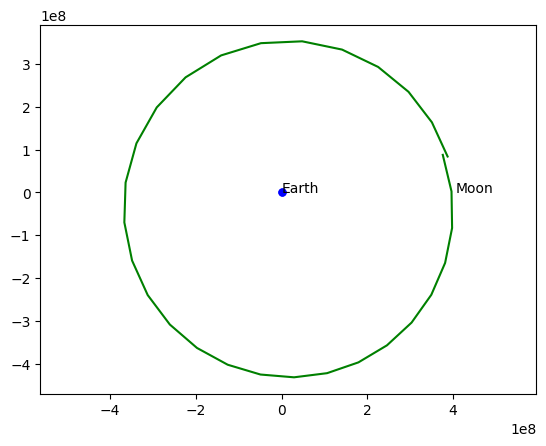

In [74]:
#We get the Moon's posistion with respect to Earth by subtracting Earth's posistion from Moon's
xlist = np.asarray(xmlist) - np.asarray(xelist)
ylist = np.asarray(ymlist) - np.asarray(yelist)

plt.plot((0, 0), marker='o', markersize=5, markeredgecolor='blue', markerfacecolor='blue')  # Earth
plt.text(0, 0, 'Earth')
plt.plot(xlist[:29], ylist[:29], '-g')  # Moon
plt.text(em, 0, 'Moon')
plt.axis('equal')
plt.show()

Moon-Earth System: Earth Fixed F.O.R

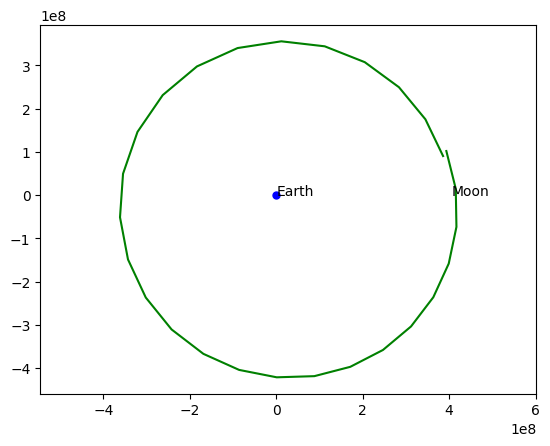

In [92]:
w = 2 * 3.1415 / (23.9345 * 60 * 60) #Angular velocity of earth's rotation
theta = 0

# Store coordinates
x, y = [], []
i = 0

# Calculating effect of Rotation
for i in range(len(xlist)):
  theta += w*dt
  x.append(xlist[i] * np.cos(theta) - ylist[i] * np.sin(theta))
  y.append(ylist[i] * np.cos(theta) + xlist[i] * np.sin(theta))
  i+=1

plt.plot(0, 0, marker = 'o', markersize = 5, markeredgecolor = 'blue', markerfacecolor = 'blue') # Earth
plt.text(0, 0,'Earth') 
plt.plot(x[:27], y[:27],'-g') # Moon
plt.text(em, 0, 'Moon')
plt.axis('equal')
plt.show()

Q4

In [97]:
# Stores the no of days the Moon is visible
visible_days = []

print('Visible days:') 
for i in range(len(x)):
    if x[i] > 0:                 # Check Moon is in one half of the plot
        visible_days.append(i)
        print(f'Day:{i}')

print(len(visible_days)) # No of days in a year

Visible days:
Day:0
Day:1
Day:2
Day:3
Day:4
Day:5
Day:17
Day:18
Day:19
Day:20
Day:21
Day:22
Day:23
Day:24
Day:25
Day:26
Day:27
Day:28
Day:29
Day:30
Day:31
Day:43
Day:44
Day:45
Day:46
Day:47
Day:48
Day:49
Day:50
Day:51
Day:52
Day:53
Day:54
Day:55
Day:56
Day:57
Day:69
Day:70
Day:71
Day:72
Day:73
Day:74
Day:75
Day:76
Day:77
Day:78
Day:79
Day:80
Day:81
Day:82
Day:83
Day:95
Day:96
Day:97
Day:98
Day:99
Day:100
Day:101
Day:102
Day:103
Day:104
Day:105
Day:106
Day:107
Day:108
Day:109
Day:121
Day:122
Day:123
Day:124
Day:125
Day:126
Day:127
Day:128
Day:129
Day:130
Day:131
Day:132
Day:133
Day:134
Day:135
Day:148
Day:149
Day:150
Day:151
Day:152
Day:153
Day:154
Day:155
Day:156
Day:157
Day:158
Day:159
Day:160
Day:174
Day:175
Day:176
Day:177
Day:178
Day:179
Day:180
Day:181
Day:182
Day:183
Day:184
Day:185
Day:186
Day:200
Day:201
Day:202
Day:203
Day:204
Day:205
Day:206
Day:207
Day:208
Day:209
Day:210
Day:211
Day:212
Day:227
Day:228
Day:229
Day:230
Day:231
Day:232
Day:233
Day:234
Day:235
Day:236
Day:237


In [99]:
# This returns the starting times when Moon is visible
# We use the library 'ephem' available 
import ephem

# Returns the list of time when moon is visble above the horizon(Angle > 0)
def moon_visibility(latitude, longitude, start_date, end_date):
    observer = ephem.Observer()
    moon = ephem.Moon()
    start_date = ephem.Date(start_date)
    end_date = ephem.Date(end_date)

    visibility_times = []

    while start_date < end_date:
        observer.date = start_date
        moon.compute(observer)

        # Check if the Moon is above the horizon
        if moon.alt > 0:
            visibility_times.append(observer.date.datetime())

        start_date += ephem.hour

    return visibility_times
 
# Example: IIT Hyderabad Co-ordinates for last year
latitude = 17.59420966420269
longitude = 78.12347819506408
start_date = "2023-01-01"
end_date = "2023-12-31"

moon_visibility_times = moon_visibility(latitude, longitude, start_date, end_date)

print("Moon visibility times:") 
for time in moon_visibility_times:
    print(time)
    
print(len(moon_visibility_times)) # Total no of times in the year

Moon visibility times:
2023-01-01 00:00:00
2023-01-01 01:00:00
2023-01-01 13:59:59.999997
2023-01-01 14:59:59.999997
2023-01-01 15:59:59.999997
2023-01-01 16:59:59.999997
2023-01-01 17:59:59.999996
2023-01-01 18:59:59.999996
2023-01-01 19:59:59.999996
2023-01-01 20:59:59.999996
2023-01-01 21:59:59.999996
2023-01-01 22:59:59.999994
2023-01-01 23:59:59.999994
2023-01-02 00:59:59.999994
2023-01-02 01:59:59.999994
2023-01-02 14:59:59.999991
2023-01-02 15:59:59.999991
2023-01-02 16:59:59.999991
2023-01-02 17:59:59.999991
2023-01-02 18:59:59.999991
2023-01-02 19:59:59.999991
2023-01-02 20:59:59.999991
2023-01-02 21:59:59.999989
2023-01-02 22:59:59.999989
2023-01-02 23:59:59.999989
2023-01-03 00:59:59.999989
2023-01-03 01:59:59.999989
2023-01-03 15:59:59.999986
2023-01-03 16:59:59.999986
2023-01-03 17:59:59.999985
2023-01-03 18:59:59.999985
2023-01-03 19:59:59.999985
2023-01-03 20:59:59.999985
2023-01-03 21:59:59.999985
2023-01-03 22:59:59.999985
2023-01-03 23:59:59.999985
2023-01-04 00:59:59